# Herpeton Project - Combined Notebook

This is an attempt to bring `notebook.ipynb` and `preprocess_bug_fix.ipynb` into a unified state for simpler working.



# Step 1: Environment Setup and Compatibility Checks

Initial runs of the notebook generated PyArrow issues so we added this to resolve if needed. It may simply run and complete sucessfully.

In [1]:
import subprocess
import sys
import importlib

def check_and_fix_pyarrow():
    """Check PyArrow version and fix compatibility issues"""
    print("Checking PyArrow compatibility")

    try:
        import pyarrow as pa
        print(f"PyArrow version: {pa.__version__}")

        # Test for the extension type attribute
        if hasattr(pa.lib, 'PyExtensionType'):
            print("PyExtensionType is available")
            return True
        else:
            print("PyExtensionType not found - version issue detected")
            return False

    except ImportError:
        print("PyArrow not installed")
        return False

def fix_pyarrow_compatibility():
    """Fix PyArrow version compatibility and numpy/pandas binary issues"""
    print("\nFixing PyArrow/Pandas/Numpy compatibility")

    try:
        # Aggressively uninstall potentially conflicting packages
        print("Uninstalling existing PyArrow, Pandas, and Numpy...")
        subprocess.check_call([sys.executable, "-m", "pip", "uninstall", "-y", "pyarrow", "pandas", "numpy"])

        # Install specific compatible versions with force-reinstall
        print("Installing compatible Numpy version (1.23.5) with force-reinstall")
        subprocess.check_call([sys.executable, "-m", "pip", "install", "--force-reinstall", "numpy==1.23.5"])

        print("Installing compatible Pandas version (2.0.3) with force-reinstall")
        subprocess.check_call([sys.executable, "-m", "pip", "install", "--force-reinstall", "pandas==2.0.3"])

        print("Installing compatible PyArrow version (14.0.2) with force-reinstall")
        subprocess.check_call([sys.executable, "-m", "pip", "install", "--force-reinstall", "pyarrow==14.0.2"])

        print("Compatibility fix complete.")
        return True

    except subprocess.CalledProcessError as e:
        print(f"Failed to fix compatibility: {e}")
        return False

def install_package(package_name, import_name=None):
    """Install a package and verify it can be imported"""
    if import_name is None:
        import_name = package_name

    try:
        # Try to import the package
        importlib.import_module(import_name)
        print(f"{package_name} is already installed")
        return True
    except ImportError:
        print(f"Installing {package_name}")
        try:
            subprocess.check_call([sys.executable, "-m", "pip", "install", package_name])
            print(f"{package_name} installed successfully")
            return True
        except subprocess.CalledProcessError as e:
            print(f"Failed to install {package_name}: {e}")
            return False

print("Setting up BioTrove Reptilia processing environment")
print("=" * 60)

should_fix_compatibility = False
try:
    import pyarrow as pa
    import pandas as pd
    import numpy as np
    print(f"Current PyArrow version: {pa.__version__}")
    print(f"Current Pandas version: {pd.__version__}")
    print(f"Current Numpy version: {np.__version__}")

    # Check if current versions are within the desired range.
    # The fix targets pyarrow==14.0.2 and pandas==2.0.3, numpy==1.23.5.
    # So, if they are not these exact versions, trigger the fix.
    if pa.__version__ != "14.0.2" or pd.__version__ != "2.0.3" or np.__version__ != "1.23.5":
        print("Detected incompatible versions for PyArrow, Pandas, or Numpy. Triggering fix.")
        should_fix_compatibility = True
    else:
        print("PyArrow, Pandas, and Numpy versions are compatible.")
except Exception as e: # Catch a broader exception here to include ValueError
    print(f"An error occurred during initial PyArrow, Pandas, or Numpy import/check: {e}")
    print("Triggering compatibility fix.")
    should_fix_compatibility = True

if should_fix_compatibility:
    print("\nAttempting to fix compatibility")
    if fix_pyarrow_compatibility():
        # Re-check after fix
        try:
            import pyarrow as pa_fixed
            import pandas as pd_fixed
            import numpy as np_fixed
            if pa_fixed.__version__ == "14.0.2" and pd_fixed.__version__ == "2.0.3" and np_fixed.__version__ == "1.23.5":
                print("PyArrow, Pandas, and Numpy issues resolved.")
            else:
                print("WARNING: PyArrow, Pandas, or Numpy issue persists after fix.")
                print(f"  PyArrow: {pa_fixed.__version__} (Expected 14.0.2)")
                print(f"  Pandas: {pd_fixed.__version__} (Expected 2.0.3)")
                print(f"  Numpy: {np_fixed.__version__} (Expected 1.23.5)")
        except ImportError:
            print("ERROR: PyArrow, Pandas, or Numpy still not importable after fix.")
    else:
        print("ERROR: Could not automatically fix compatibility for PyArrow, Pandas, Numpy. You may need to restart the runtime and try again.")

print("\n" + "=" * 60)

# List of required packages (with specific versions to avoid conflicts)
required_packages = [
    ("arbor-process", "arbor_process"),
    ("nest_asyncio", "nest_asyncio"),
    ("datasets>=2.14.0", "datasets"),
    ("matplotlib", "matplotlib"),
    ("seaborn", "seaborn"),
    ("pillow", "PIL"),
    ("requests", "requests"),
    ("tqdm", "tqdm"),
    ("python-dotenv", "dotenv"),
    ("huggingface_hub", "huggingface_hub"),
    ("webdataset", "webdataset")
]

# Install packages
all_installed = True
for package_name, import_name in required_packages:
    if not install_package(package_name, import_name):
        all_installed = False

if all_installed:
    print("\nAll packages installed successfully")
    print("Ready to process BioTrove Reptilia dataset")
else:
    print("\nWARNING: Some packages failed to install")
    print("You may need to install them manually")

print("\nNOTE: If PyArrow errors persist, try:")
print("   pip install --force-reinstall pyarrow==14.0.2")
print("   pip install --force-reinstall pandas==2.0.3")
print("   pip install --force-reinstall numpy==1.23.5")
print("   If problems persist, try restarting your Colab runtime (Runtime > Restart runtime) and re-running the cells.")

print("\n" + "=" * 60)

Setting up BioTrove Reptilia processing environment
Current PyArrow version: 22.0.0
Current Pandas version: 2.3.3
Current Numpy version: 2.3.5
Detected incompatible versions for PyArrow, Pandas, or Numpy. Triggering fix.

Attempting to fix compatibility

Fixing PyArrow/Pandas/Numpy compatibility
Uninstalling existing PyArrow, Pandas, and Numpy...
Installing compatible Numpy version (1.23.5) with force-reinstall
Failed to fix compatibility: Command '['/usr/bin/python3', '-m', 'pip', 'install', '--force-reinstall', 'numpy==1.23.5']' returned non-zero exit status 1.
ERROR: Could not automatically fix compatibility for PyArrow, Pandas, Numpy. You may need to restart the runtime and try again.

arbor-process is already installed
nest_asyncio is already installed
Installing datasets>=2.14.0
datasets>=2.14.0 installed successfully
matplotlib is already installed
seaborn is already installed
pillow is already installed
requests is already installed
tqdm is already installed
python-dotenv is al

# Step 2: Import Required Libraries

Import all necessary libraries for the BioTrove processing pipeline.

In [14]:
# Core imports
import os
import random
import shutil
import time
import json
import pandas as pd
import numpy as np
import webdataset as wds
import math
from pathlib import Path
from dotenv import load_dotenv
from tqdm import tqdm

# HuggingFace and BioTrove tools
from huggingface_hub import snapshot_download
from arbor_process import MetadataProcessor, GenShuffledChunks, GetImages, GenImgTxtPair

# For async operations
import nest_asyncio
nest_asyncio.apply()

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

print("All libraries imported successfully.")

All libraries imported successfully.


In [3]:
#@title Mount Google Drive
CURATE_TO_DRIVE = True

if CURATE_TO_DRIVE:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)
    BASE_OUT = "/content/drive/MyDrive/herpeton"
else:
    BASE_OUT = "/content/herpeton"

os.makedirs(BASE_OUT, exist_ok=True)

# Controls to keep runtime reasonable
MAX_RECORDS = 15000          # hard cap across the stream (increase if you have time/compute)
SAMPLE_PER_SPECIES = 120     # images per species to collect/curate/EDA
REPORT_DIR = os.path.join(BASE_OUT, "_reports")
os.makedirs(REPORT_DIR, exist_ok=True)

print(f"Output base: {BASE_OUT}")
print(f"Reports   : {REPORT_DIR}")
print(f"Limits    : MAX_RECORDS={MAX_RECORDS}, SAMPLE_PER_SPECIES={SAMPLE_PER_SPECIES}")

Mounted at /content/drive
Output base: /content/drive/MyDrive/herpeton
Reports   : /content/drive/MyDrive/herpeton/_reports
Limits    : MAX_RECORDS=15000, SAMPLE_PER_SPECIES=120


# Step 3: Environment Configuration

Load environment variables and configure HuggingFace authentication.

In [4]:
# Fetch HF token from .env
load_dotenv()

hf_token = os.getenv("HF_TOKEN") # This expects an .env file with HF_TOKEN variable and the .env file is identitifed in the .gitignore file.

# Check if HF token is available
if hf_token is None:
    print("WARNING: HF_TOKEN not found in environment variables.")

else:
    print("HuggingFace token loaded successfully")

# Step 4: Configure Directory Structure

Set up the directory structure for data processing.

In [5]:
# Configure all data paths
DATA_ROOT = Path("/content/drive/MyDrive/herpeton/data/biotrove_train")
META_DIR = DATA_ROOT / "raw_metadata"
PARAQUETS_PATH = META_DIR / "BioTrove-Train"
OUT_DIR = DATA_ROOT / "processed_metadata"
FILTERED_OUT = DATA_ROOT / "filtered_reptilia"
INPUT_PARQUETS = FILTERED_OUT / "merged_cases"
IMG_DIR = DATA_ROOT / "images_reptilia"
SPLITS_CSV = DATA_ROOT / "reptilia_tar_splits.csv"
COUNTS = DATA_ROOT / "processed_metadata" / "combined_sample_counts_per_species.csv"

# Create directories
META_DIR.mkdir(parents=True, exist_ok=True)
OUT_DIR.mkdir(parents=True, exist_ok=True)
INPUT_PARQUETS.mkdir(parents=True, exist_ok=True)
IMG_DIR.mkdir(parents=True, exist_ok=True)

print("Directory structure created:")
print(f"  Data root: {DATA_ROOT}")
print(f"  Metadata: {META_DIR}")
print(f"  Processed: {OUT_DIR}")
print(f"  Images: {IMG_DIR}")

Directory structure created:
  Data root: /content/drive/MyDrive/herpeton/data/biotrove_train
  Metadata: /content/drive/MyDrive/herpeton/data/biotrove_train/raw_metadata
  Processed: /content/drive/MyDrive/herpeton/data/biotrove_train/processed_metadata
  Images: /content/drive/MyDrive/herpeton/data/biotrove_train/images_reptilia


# Step 5: Download BioTrove Metadata

Download metadata from HuggingFace (parquet files only).

In [6]:
# Download the biotrove-train metadata from huggingface
print("Downloading BioTrove metadata from HuggingFace")
print("=" * 60)

snapshot_download(
    repo_id="BGLab/BioTrove-Train",
    repo_type="dataset",
    local_dir=str(META_DIR),
    # Only download parquet files
    allow_patterns=["BioTrove-Train/*.parquet"],
    force_download=True,
)

print("\nMetadata download complete")

# Check downloaded files
parquet_files = list(PARAQUETS_PATH.glob("*.parquet"))
print(f"Downloaded {len(parquet_files)} parquet files")

Fetching 2692 files:   0%|          | 0/2692 [00:00<?, ?it/s]

BioTrove-Train/chunk_1.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_1000.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1001.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_100.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1002.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_10.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1003.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_0.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_1004.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1005.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1006.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1008.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1007.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_101.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1009.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1010.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1011.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1012.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1013.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1014.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1016.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1015.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1017.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1018.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1019.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_102.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_1020.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1022.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1021.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1023.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1024.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1025.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1026.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1027.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1028.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1029.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_103.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_1030.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1031.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1033.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1032.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1034.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1036.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1035.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_1037.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_1038.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1039.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_104.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_1040.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1041.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1042.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1043.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1044.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1045.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1046.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1048.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1047.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1049.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_105.parquet:   0%|          | 0.00/1.63M [00:00<?, ?B/s]

BioTrove-Train/chunk_1051.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1050.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1052.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1053.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1054.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1055.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1056.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1058.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1057.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1059.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_106.parquet:   0%|          | 0.00/1.63M [00:00<?, ?B/s]

BioTrove-Train/chunk_1060.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1062.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1061.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1063.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1064.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1066.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1065.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1067.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1068.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1069.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_107.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_1070.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1071.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1072.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1073.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1074.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1075.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1076.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1078.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1077.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1079.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1080.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_108.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_1081.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1082.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1083.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1084.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1085.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1086.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1087.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1088.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1089.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_109.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_1090.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1091.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1093.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1092.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1094.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1095.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1096.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1097.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1099.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1098.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_11.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_1101.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_110.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_1100.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1102.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1103.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1104.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1105.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1106.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1107.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1108.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1109.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_111.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1110.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1111.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1112.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1113.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1114.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1115.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1116.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1117.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1118.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1119.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_112.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1120.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1121.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1122.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1123.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1124.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1125.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1126.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1127.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1128.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1129.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_113.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1130.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1132.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1131.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1133.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1134.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1135.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1136.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1137.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1138.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_114.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_1139.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1141.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1140.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1142.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1143.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1144.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1145.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1147.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_1146.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1148.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1149.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_115.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1150.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1151.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1152.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1153.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1154.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1155.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1156.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1157.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1158.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1159.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_116.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1160.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1162.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1164.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1161.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1163.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1165.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1166.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1167.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1168.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_117.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1169.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1170.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1171.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1172.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1173.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1174.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1177.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1175.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1176.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1178.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1179.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_118.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1180.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1181.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1183.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1184.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1182.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1185.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1187.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1186.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1188.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1189.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1190.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_119.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1192.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1191.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1193.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1194.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1195.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1196.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1198.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_12.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_1197.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1199.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_120.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1201.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1200.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1202.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1203.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1205.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1204.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1206.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1207.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1209.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1208.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_121.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1210.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1212.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1211.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1214.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1213.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1215.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1216.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1217.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1218.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1219.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1220.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_122.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1221.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1223.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1222.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1225.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1224.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1227.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1226.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1228.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1229.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_123.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1230.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1231.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1232.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1233.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1234.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1235.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1237.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1238.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1236.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_1239.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1240.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_124.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1241.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1242.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1243.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1244.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1245.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1246.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1247.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1248.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1249.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_125.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1250.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1251.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1253.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1252.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1254.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1255.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1256.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1257.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_126.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1258.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1259.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1260.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1263.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1262.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1261.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1264.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1266.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_1265.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1267.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1268.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1269.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_127.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1270.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1271.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1272.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1273.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_1275.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1274.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_1278.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1276.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1277.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1279.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_128.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1280.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1281.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1282.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1284.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1283.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1286.parquet:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

BioTrove-Train/chunk_1285.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1287.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1288.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1289.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_129.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1290.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1291.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1292.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1293.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1294.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1295.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1297.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1296.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1298.parquet:   0%|          | 0.00/1.33M [00:00<?, ?B/s]

BioTrove-Train/chunk_13.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_1299.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_130.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1300.parquet:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

BioTrove-Train/chunk_1301.parquet:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

BioTrove-Train/chunk_1302.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1303.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1304.parquet:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

BioTrove-Train/chunk_1305.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1306.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1308.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1307.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_131.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1310.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1311.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1309.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1312.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1313.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1314.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1315.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1316.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1317.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1318.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1319.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_132.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1320.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1322.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1321.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1324.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1323.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1326.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1328.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1325.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1327.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1329.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_133.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1330.parquet:   0%|          | 0.00/1.33M [00:00<?, ?B/s]

BioTrove-Train/chunk_1331.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1332.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1333.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1334.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1335.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1337.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1338.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1336.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1339.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_134.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1340.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1341.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1342.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1343.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1344.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1345.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1346.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1347.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1348.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1349.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_135.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1350.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1351.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1352.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1353.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1354.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1355.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1356.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1358.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1357.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1359.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_136.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1360.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1361.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1362.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1363.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1365.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1364.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1367.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1366.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1368.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_137.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1369.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1370.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1371.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1372.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1373.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1374.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1375.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1377.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1376.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1379.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1378.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_138.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1380.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1381.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1383.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1382.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1384.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1385.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1387.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1386.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1388.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1389.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_139.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1390.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1391.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1392.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1393.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1394.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1395.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1396.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1397.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1398.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1399.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1400.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_14.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_140.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1401.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1402.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1403.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1404.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1405.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1406.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1407.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1408.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1409.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_141.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1410.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1411.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1412.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1414.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1413.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1415.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1416.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1418.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1417.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1419.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_142.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1420.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1421.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1422.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1423.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1426.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1424.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1425.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1427.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1428.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1429.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_143.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1430.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1431.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1433.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1432.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1434.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1435.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1436.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1437.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1438.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1439.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_144.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1441.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1440.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1442.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1443.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1444.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1446.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1445.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1447.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1448.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1449.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_145.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1450.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1451.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1452.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1453.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1454.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1455.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1456.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1458.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1459.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1457.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_146.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1460.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1461.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1462.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1463.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1465.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1466.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1464.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1468.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1467.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1469.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_147.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1470.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1471.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1472.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1473.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1475.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1476.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1474.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1477.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1479.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_148.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1478.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1480.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1483.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1481.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1482.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1484.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1485.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1486.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1487.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1488.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1489.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_149.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1490.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1491.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1492.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1493.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1494.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1495.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1496.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1497.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1498.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1499.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1500.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_150.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_15.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_1501.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1502.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1503.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1505.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1504.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1506.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1507.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1508.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1509.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_151.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_1510.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1511.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1512.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1513.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1515.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1516.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1514.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1517.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1518.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1519.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_152.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_1520.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1522.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1521.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1523.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1524.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1525.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1526.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1527.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1528.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1529.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_153.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_1530.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1531.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1532.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1533.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1534.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1535.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1536.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1537.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1538.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1539.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_154.parquet:   0%|          | 0.00/1.64M [00:00<?, ?B/s]

BioTrove-Train/chunk_1540.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1542.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1541.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1544.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1543.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1545.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1546.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1547.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1548.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1549.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_155.parquet:   0%|          | 0.00/1.63M [00:00<?, ?B/s]

BioTrove-Train/chunk_1550.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1551.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1552.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1553.parquet:   0%|          | 0.00/1.37M [00:00<?, ?B/s]

BioTrove-Train/chunk_1554.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1555.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1556.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1557.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1559.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1558.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_156.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_1560.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1561.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_1562.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1563.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1564.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1565.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1566.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1567.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1568.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1569.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_157.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_1571.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1570.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1572.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1573.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1574.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1575.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1576.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1577.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1578.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1579.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1580.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_158.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_1581.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1582.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1583.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1584.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1585.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1586.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1587.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_159.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_1589.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1588.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1590.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1592.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1591.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1593.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1594.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1595.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1596.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1597.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1598.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1599.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_16.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_160.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_1600.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1602.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1601.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1603.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1604.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1606.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1605.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1608.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1607.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_161.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_1610.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1609.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1611.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1612.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1613.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1614.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1615.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1616.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1617.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1618.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1619.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_162.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_1620.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1622.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1621.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1623.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_1624.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1625.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1626.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1627.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1629.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_1628.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1630.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_163.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_1631.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1632.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1633.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1634.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1635.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1637.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1638.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1636.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1639.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_164.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_1640.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1641.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1642.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1643.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1644.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1645.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1646.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1647.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1648.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_165.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1649.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1650.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1652.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1651.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1654.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1653.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1655.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1656.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1659.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1657.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1658.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1660.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_166.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1661.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1662.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1663.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1664.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1665.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1666.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1667.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1668.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1669.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_167.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1670.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1672.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1671.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1673.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1674.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1675.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1676.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1677.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1678.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_168.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1680.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1679.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1681.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1682.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1684.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1683.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1685.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1686.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1687.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1688.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1689.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_169.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1690.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1691.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1693.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1696.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1692.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1694.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1695.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1697.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1698.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1699.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_17.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_170.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_1701.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1702.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1700.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1703.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1704.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1706.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1705.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1707.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1709.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1708.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_171.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1710.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1711.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1712.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1713.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1715.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1714.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1716.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1717.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1718.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1719.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_172.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1721.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1720.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1723.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1724.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1722.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1725.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1726.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1728.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1729.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1727.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_173.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_1731.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1730.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1733.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1732.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1734.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1735.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1736.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1737.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1738.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_174.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1739.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1740.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1742.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1741.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1743.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1744.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1745.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1747.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1746.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1748.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1749.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_175.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_1750.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1751.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1752.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1753.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1754.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1755.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1756.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1758.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1757.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1759.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_176.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1760.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1761.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1762.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_1764.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1763.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1765.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1766.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1767.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1768.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1769.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_177.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1771.parquet:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

BioTrove-Train/chunk_1770.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1772.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1773.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1774.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1775.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1776.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1777.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1778.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1779.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_178.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1780.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1781.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1783.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1782.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1786.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1785.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1784.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1787.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1788.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1789.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_179.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1791.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1792.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1794.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1790.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1793.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1795.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1796.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1797.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1799.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1798.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_18.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_180.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1800.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1801.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1802.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1803.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1804.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1805.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1807.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1806.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1808.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1809.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_181.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1810.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1811.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1813.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1812.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1815.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1814.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1816.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1817.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1818.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1819.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_182.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1820.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1821.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1822.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1823.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1824.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1825.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1826.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1828.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1827.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1829.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_183.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1832.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1831.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1833.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1830.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1835.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1834.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1836.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1837.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1838.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1839.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_184.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1841.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1840.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1842.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1843.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1844.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1845.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1846.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1847.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1848.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1849.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_1851.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_1850.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_185.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1852.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_1853.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1855.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_1854.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1856.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1857.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1858.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_1859.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_1860.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_1861.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1862.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_186.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1863.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1864.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1865.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1868.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_1867.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1866.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_187.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1870.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1871.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1869.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1872.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1873.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1874.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1875.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1876.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1877.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1878.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1879.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_188.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1881.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1882.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1880.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1883.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1884.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1886.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1885.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1887.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1888.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1889.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1891.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1890.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_189.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1892.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1893.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1894.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1895.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1896.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1898.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1897.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1899.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_19.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_190.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1900.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1901.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1902.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1903.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1904.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1905.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1906.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1908.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1907.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1909.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_191.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1910.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1911.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_1913.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1912.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_1914.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1915.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1916.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1917.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1918.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_192.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1920.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1923.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1921.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1919.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1922.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1924.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1925.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1926.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1927.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1928.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1929.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_193.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1930.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1931.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1932.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1933.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1935.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1937.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1936.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1939.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1938.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1934.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_194.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1940.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1941.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1942.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1943.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1944.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1946.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1945.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1947.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1948.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1949.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_195.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1950.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1952.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1953.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1954.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1955.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1951.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1956.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1958.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1959.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1957.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_196.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1961.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1960.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1962.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1964.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1965.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1963.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1966.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1967.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1968.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1969.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_197.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1970.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1972.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1973.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1971.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1974.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1975.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1976.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1977.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1978.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_198.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1981.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1979.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1980.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1982.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1983.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1984.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1985.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1986.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1987.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1988.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1989.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_199.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1990.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1991.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_1992.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1993.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_1994.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_1995.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1996.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1997.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_1999.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_1998.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_20.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_200.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2000.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2001.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2002.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2004.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2003.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2006.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2007.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2005.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2008.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2009.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2010.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2011.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_201.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2013.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2012.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2015.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2016.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2014.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2017.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2018.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2019.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_202.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2020.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2021.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2023.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2022.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2024.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2025.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2026.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2027.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2028.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2029.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_203.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2030.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2032.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2031.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2033.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2034.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2036.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2035.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2037.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2038.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2039.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_204.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2041.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2042.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2043.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2040.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2044.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2046.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2045.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2048.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2049.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_2047.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_205.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2050.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2051.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2052.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_2053.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_2055.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2054.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2056.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2058.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2057.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2059.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_206.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2060.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2061.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_2062.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2063.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2064.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2065.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2066.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2067.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2069.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2068.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2070.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2071.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_207.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2072.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2073.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2074.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2075.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2078.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2076.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2077.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2079.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_208.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2080.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2081.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2082.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2083.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2085.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2084.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2086.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2087.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2089.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_209.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2090.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2088.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2091.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2093.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2092.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2094.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2095.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2098.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2096.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2097.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2099.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_21.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_210.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2100.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2101.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2103.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2102.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2104.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2105.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2106.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2107.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2108.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_2109.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_211.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2110.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2111.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2113.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2114.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2112.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2115.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2116.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2117.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2118.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_212.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2119.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2120.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2121.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2122.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2123.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2124.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2125.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2128.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2126.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2127.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2129.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_213.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2130.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2131.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2132.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2133.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2135.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2134.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2136.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2137.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2138.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2139.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_214.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2140.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2142.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2141.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2143.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2144.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2145.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2146.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2147.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2150.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2148.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2152.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2149.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2151.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_215.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2153.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2154.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2155.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2156.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2157.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2158.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2159.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_216.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2160.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_2161.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2163.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2164.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2165.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2166.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2162.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2167.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2168.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2169.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_217.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2171.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2172.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2173.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2174.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2170.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2175.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2176.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2177.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2178.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2179.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2181.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_218.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2182.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2183.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2180.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2184.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2185.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2186.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2187.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2188.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2189.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2190.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_219.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2192.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2191.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2193.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2195.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2194.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2196.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2197.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2198.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_22.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_220.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2199.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2200.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2201.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2202.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2203.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2204.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2205.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2206.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2207.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2210.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2208.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_221.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2209.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2211.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2212.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2213.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2214.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2215.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2218.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2216.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2217.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2219.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_222.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2220.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2221.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2223.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2222.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2224.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2225.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2226.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2227.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2228.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2229.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2230.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_223.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2231.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2232.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2233.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2234.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2235.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2236.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2237.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2238.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2239.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_224.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2240.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2241.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2243.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2242.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2245.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2244.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2247.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2248.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2249.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2246.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_225.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2250.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2252.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2251.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2253.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2254.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2255.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2257.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2256.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2258.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2259.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2260.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_226.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2261.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2262.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2264.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2263.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2265.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2266.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2267.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2268.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2269.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_227.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2271.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2270.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2272.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2273.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2275.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2274.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2276.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2277.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2279.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2278.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_228.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2280.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2282.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2281.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2283.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2284.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2285.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2286.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2287.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2288.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_229.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2289.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2290.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2291.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2292.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2293.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2294.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2295.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2296.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2297.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2299.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2298.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_23.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_230.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_2300.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2302.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2301.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2303.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2304.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2308.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2306.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2305.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2309.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_231.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2307.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2310.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2311.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2312.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2313.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2314.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2316.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2315.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2317.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2318.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2319.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_232.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2320.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2322.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2321.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2324.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2323.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2325.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2327.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2326.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2329.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2328.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_233.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2330.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2331.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2332.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2333.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2334.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2335.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2336.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2337.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2338.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2339.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_234.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2341.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2340.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2342.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2343.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2344.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2345.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2346.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2347.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2349.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2348.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_235.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2352.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2351.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2350.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2353.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2354.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2355.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2358.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2356.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2357.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_236.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_2359.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2360.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2362.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2361.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2363.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2364.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2365.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2367.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2366.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2369.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2368.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_237.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_2370.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2372.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2371.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2373.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2374.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2376.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2375.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2377.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2378.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_2379.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_238.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_2380.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_2381.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2384.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2382.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2385.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2383.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2386.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2387.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2388.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_2390.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2389.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_239.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_2391.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2392.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2393.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2394.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2395.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2397.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2396.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2398.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2399.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_24.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_240.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_2400.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2401.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2402.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2403.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2406.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2404.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2405.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2407.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2408.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2409.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_241.parquet:   0%|          | 0.00/1.63M [00:00<?, ?B/s]

BioTrove-Train/chunk_2411.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2410.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2412.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2414.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2413.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2415.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2416.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2418.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2417.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2419.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_242.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_2421.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2420.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2422.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2423.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2425.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2424.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2426.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2428.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2427.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2429.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_243.parquet:   0%|          | 0.00/1.63M [00:00<?, ?B/s]

BioTrove-Train/chunk_2430.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2431.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2432.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2433.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2434.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2435.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2436.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2437.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2438.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2439.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_244.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_2440.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2442.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2441.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_2444.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_2443.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2445.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2446.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2447.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2449.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_245.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_2450.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2448.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2451.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_2452.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2453.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2454.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2455.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2456.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2458.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2457.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_2459.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2461.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_246.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_2460.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2462.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2464.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2463.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2465.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2466.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2467.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2469.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2468.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_2470.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_2471.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_247.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_2472.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_2473.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_2474.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2475.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2476.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2477.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2478.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2479.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_248.parquet:   0%|          | 0.00/1.63M [00:00<?, ?B/s]

BioTrove-Train/chunk_2480.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2481.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2482.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2485.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2483.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2484.parquet:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

BioTrove-Train/chunk_2486.parquet:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

BioTrove-Train/chunk_2487.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2488.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2489.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_249.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_2490.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2491.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2492.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2493.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2494.parquet:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

BioTrove-Train/chunk_2495.parquet:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

BioTrove-Train/chunk_2496.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2497.parquet:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

BioTrove-Train/chunk_2498.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_25.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_2500.parquet:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

BioTrove-Train/chunk_2499.parquet:   0%|          | 0.00/1.34M [00:00<?, ?B/s]

BioTrove-Train/chunk_250.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_2501.parquet:   0%|          | 0.00/1.34M [00:00<?, ?B/s]

BioTrove-Train/chunk_2502.parquet:   0%|          | 0.00/1.33M [00:00<?, ?B/s]

BioTrove-Train/chunk_2503.parquet:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

BioTrove-Train/chunk_2504.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2505.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2506.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2507.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2509.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2508.parquet:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

BioTrove-Train/chunk_251.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_2510.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2511.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2512.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2513.parquet:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

BioTrove-Train/chunk_2514.parquet:   0%|          | 0.00/1.31M [00:00<?, ?B/s]

BioTrove-Train/chunk_2515.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2516.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2517.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2519.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_252.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_2520.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2521.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2522.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2518.parquet:   0%|          | 0.00/1.40M [00:00<?, ?B/s]

BioTrove-Train/chunk_2523.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2524.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2525.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2526.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2527.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_253.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_2529.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2528.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2531.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2530.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2533.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_2532.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_2534.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_2536.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2537.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2535.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2538.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2539.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2540.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_254.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_2542.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2541.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2544.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_2545.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_2546.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2543.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2547.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_255.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2550.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2549.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2553.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2548.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2552.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2551.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2554.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2555.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2556.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2557.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2558.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2559.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_256.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2560.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2561.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_2562.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_2564.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2563.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_2565.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2566.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2567.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2568.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2569.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_257.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_2571.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2570.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2572.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2573.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2574.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2575.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2576.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2577.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2578.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2579.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_258.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2580.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2581.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2582.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2583.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2585.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2584.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2587.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2586.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2590.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2588.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_259.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2589.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2591.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2593.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2594.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2592.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2595.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2596.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2597.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_26.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_2599.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2598.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_260.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2601.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2600.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2602.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2603.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2604.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2605.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2607.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_2609.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_2608.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2606.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_261.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2610.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_2611.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2612.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2613.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2614.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2616.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2615.parquet:   0%|          | 0.00/1.25M [00:00<?, ?B/s]

BioTrove-Train/chunk_2618.parquet:   0%|          | 0.00/1.27M [00:00<?, ?B/s]

BioTrove-Train/chunk_2619.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_2617.parquet:   0%|          | 0.00/1.26M [00:00<?, ?B/s]

BioTrove-Train/chunk_2620.parquet:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

BioTrove-Train/chunk_262.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2621.parquet:   0%|          | 0.00/1.28M [00:00<?, ?B/s]

BioTrove-Train/chunk_2623.parquet:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

BioTrove-Train/chunk_2622.parquet:   0%|          | 0.00/1.30M [00:00<?, ?B/s]

BioTrove-Train/chunk_2626.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_2624.parquet:   0%|          | 0.00/1.13M [00:00<?, ?B/s]

BioTrove-Train/chunk_2625.parquet:   0%|          | 0.00/1.13M [00:00<?, ?B/s]

BioTrove-Train/chunk_2627.parquet:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

BioTrove-Train/chunk_2628.parquet:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

BioTrove-Train/chunk_2629.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_263.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2630.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2632.parquet:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

BioTrove-Train/chunk_2633.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2631.parquet:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

BioTrove-Train/chunk_2634.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2635.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2636.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2638.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2637.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_2639.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_264.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_2640.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2641.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2642.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2643.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_2644.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_2645.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2646.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2648.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2647.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2649.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_265.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2650.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2651.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2652.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2654.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2653.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_2656.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2655.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_2657.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2659.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2658.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2660.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_266.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_2661.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2662.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2663.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2664.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2665.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2666.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_2667.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2668.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_2669.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_267.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2670.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2671.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2672.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2673.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2674.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2676.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2675.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2677.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2679.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2678.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_268.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_2680.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_2681.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_2683.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_2684.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_2682.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_2685.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_2686.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2687.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_2688.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_2689.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_269.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_2690.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_2691.parquet:   0%|          | 0.00/1.09M [00:00<?, ?B/s]

BioTrove-Train/chunk_27.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_270.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_271.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_273.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_272.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_274.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_277.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_276.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_275.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_278.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_279.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_28.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_280.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_281.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_282.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_283.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_284.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_285.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_286.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_289.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_287.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_288.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_29.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_291.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_290.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_292.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_293.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_294.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_295.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_296.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_298.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_297.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_299.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_3.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_30.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_300.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_301.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_302.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_303.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_304.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_305.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_306.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_307.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_308.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_31.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_310.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_311.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_309.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_312.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_313.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_314.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_315.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_316.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_317.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_318.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_319.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_32.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_321.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_320.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_323.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_322.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_324.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_326.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_327.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_328.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_329.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_325.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_33.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_330.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_331.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_333.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_332.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_335.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_336.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_334.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_337.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_338.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_34.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_339.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_340.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_342.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_341.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_343.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_344.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_345.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_346.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_347.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_348.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_349.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_35.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_351.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_350.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_352.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_353.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_355.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_354.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_356.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_358.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_357.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_36.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_359.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_360.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_362.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_361.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_363.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_364.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_365.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_366.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_367.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_368.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_369.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_37.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_370.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_371.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_372.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_373.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_374.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_375.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_376.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_377.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_379.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_378.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_38.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_380.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_381.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_383.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_382.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_384.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_385.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_387.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_388.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_386.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_39.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_389.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_390.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_391.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_392.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_393.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_395.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_396.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_394.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_397.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_398.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_399.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_4.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_400.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_40.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_401.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_403.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_402.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_404.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_405.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_406.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_408.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_407.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_409.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_41.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_410.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_412.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_413.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_411.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_414.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_415.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_416.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_417.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_418.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_42.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_419.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_420.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_421.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_422.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_423.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_425.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_426.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_424.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_427.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_428.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_429.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_43.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_430.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_431.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_432.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_435.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_433.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_436.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_434.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_437.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_438.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_439.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_44.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_440.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_443.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_442.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_441.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_444.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_445.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_446.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_447.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_448.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_449.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_45.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_450.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_451.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_452.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_453.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_454.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_455.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_456.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_457.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_459.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_458.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_46.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_460.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_461.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_462.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_463.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_465.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_466.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_464.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_467.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_468.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_469.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_47.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_470.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_471.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_472.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_474.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_473.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_475.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_476.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_477.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_478.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_479.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_48.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_480.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_482.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_481.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_483.parquet:   0%|          | 0.00/1.63M [00:00<?, ?B/s]

BioTrove-Train/chunk_484.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_485.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_486.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_487.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_488.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_489.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_49.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_490.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_491.parquet:   0%|          | 0.00/1.63M [00:00<?, ?B/s]

BioTrove-Train/chunk_492.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_496.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_493.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_495.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_497.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_498.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_494.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_500.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_499.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_5.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_50.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_501.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_502.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_503.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_504.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_505.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_506.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_507.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_508.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_509.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_51.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_510.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_511.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_513.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_512.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_514.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_515.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_516.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_517.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_518.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_519.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_52.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_520.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_521.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_522.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_523.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_524.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_525.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_526.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_527.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_528.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_529.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_53.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_530.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_531.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_532.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_533.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_536.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_534.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_535.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_537.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_538.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_539.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_54.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_541.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_540.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_542.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_543.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_544.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_545.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_546.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_547.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_548.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_549.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_55.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_550.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_551.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_552.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_553.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_554.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_555.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_556.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_557.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_559.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_558.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_56.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_560.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_561.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_562.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_563.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_565.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_564.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_566.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_567.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_568.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_569.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_57.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_570.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_571.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_573.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_572.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_575.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_574.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_578.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_577.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_579.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_58.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_580.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_581.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_576.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_582.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_583.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_584.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_585.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_588.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_586.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_589.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_587.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_59.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_591.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_590.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_592.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_593.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_594.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_595.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_597.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_598.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_596.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_599.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_6.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_600.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_601.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_60.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_602.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_604.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_603.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_605.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_606.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_609.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_608.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_607.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_61.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_610.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_611.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_612.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_613.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_614.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_615.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_616.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_617.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_618.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_62.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_619.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_620.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_622.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_623.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_621.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_624.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_625.parquet:   0%|          | 0.00/1.51M [00:00<?, ?B/s]

BioTrove-Train/chunk_626.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_627.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_628.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_629.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_63.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_632.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_630.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_633.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_631.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_634.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_636.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_635.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_639.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_638.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_637.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_64.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_640.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_641.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_642.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_643.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_644.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_645.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_646.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_648.parquet:   0%|          | 0.00/1.62M [00:00<?, ?B/s]

BioTrove-Train/chunk_649.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_647.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_65.parquet:   0%|          | 0.00/1.41M [00:00<?, ?B/s]

BioTrove-Train/chunk_650.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_651.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_652.parquet:   0%|          | 0.00/1.61M [00:00<?, ?B/s]

BioTrove-Train/chunk_653.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_654.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_655.parquet:   0%|          | 0.00/1.58M [00:00<?, ?B/s]

BioTrove-Train/chunk_656.parquet:   0%|          | 0.00/1.59M [00:00<?, ?B/s]

BioTrove-Train/chunk_659.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_657.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_66.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_658.parquet:   0%|          | 0.00/1.57M [00:00<?, ?B/s]

BioTrove-Train/chunk_662.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_660.parquet:   0%|          | 0.00/1.55M [00:00<?, ?B/s]

BioTrove-Train/chunk_661.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_663.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_664.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_666.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_665.parquet:   0%|          | 0.00/1.54M [00:00<?, ?B/s]

BioTrove-Train/chunk_667.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_668.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_669.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_67.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_670.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_671.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_672.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_676.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_675.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_673.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_674.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_677.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_678.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_680.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_68.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_679.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_683.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_682.parquet:   0%|          | 0.00/1.50M [00:00<?, ?B/s]

BioTrove-Train/chunk_681.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_684.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_685.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_686.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_688.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_691.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_687.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_689.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_69.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_690.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_692.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_693.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_694.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_696.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_695.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_698.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_697.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_699.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_7.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_70.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_700.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_701.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_703.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_702.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_704.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_705.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_707.parquet:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

BioTrove-Train/chunk_706.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_708.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_709.parquet:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

BioTrove-Train/chunk_71.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_710.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_712.parquet:   0%|          | 0.00/1.14M [00:00<?, ?B/s]

BioTrove-Train/chunk_711.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_713.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_714.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_715.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_716.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_718.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_719.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_720.parquet:   0%|          | 0.00/1.15M [00:00<?, ?B/s]

BioTrove-Train/chunk_72.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_721.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_722.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_717.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_723.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_724.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_725.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_726.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_727.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_728.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_729.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_73.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_730.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_731.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_732.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_733.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_734.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_735.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_736.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_737.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_738.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_739.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_74.parquet:   0%|          | 0.00/1.42M [00:00<?, ?B/s]

BioTrove-Train/chunk_740.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_741.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_742.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_743.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_745.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_744.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_746.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_747.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_748.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_749.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_75.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_750.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_751.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_752.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_754.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_753.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_756.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_755.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_757.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_758.parquet:   0%|          | 0.00/1.16M [00:00<?, ?B/s]

BioTrove-Train/chunk_759.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_760.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_76.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_761.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_762.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_763.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_764.parquet:   0%|          | 0.00/1.23M [00:00<?, ?B/s]

BioTrove-Train/chunk_765.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_766.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_767.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_768.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_769.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_77.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_770.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_771.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_773.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_772.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_774.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_775.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_777.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_776.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_778.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_779.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_780.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_782.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_781.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_783.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_784.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_786.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_785.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_788.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_787.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_789.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_79.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_790.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_792.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_791.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_793.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_794.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_795.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_796.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_797.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_798.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_799.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_80.parquet:   0%|          | 0.00/1.60M [00:00<?, ?B/s]

BioTrove-Train/chunk_8.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_800.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_801.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_802.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_803.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_804.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_805.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_806.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_807.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_808.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_809.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_78.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_81.parquet:   0%|          | 0.00/1.56M [00:00<?, ?B/s]

BioTrove-Train/chunk_810.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_811.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_812.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_814.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_815.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_813.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_816.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_818.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_817.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_819.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_82.parquet:   0%|          | 0.00/1.53M [00:00<?, ?B/s]

BioTrove-Train/chunk_820.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_821.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_822.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_823.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_824.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_825.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_826.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_827.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_828.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_829.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_83.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_830.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_831.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_832.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_833.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_834.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_835.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_836.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_837.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_838.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_839.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_84.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_840.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_841.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_842.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_843.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_844.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_845.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_846.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_847.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_848.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_849.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_850.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_85.parquet:   0%|          | 0.00/1.52M [00:00<?, ?B/s]

BioTrove-Train/chunk_852.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_851.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_853.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_854.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_855.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_856.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_857.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_858.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_859.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_86.parquet:   0%|          | 0.00/1.49M [00:00<?, ?B/s]

BioTrove-Train/chunk_860.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_861.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_862.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_863.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_864.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_865.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_866.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_867.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_868.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_869.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_87.parquet:   0%|          | 0.00/1.48M [00:00<?, ?B/s]

BioTrove-Train/chunk_870.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_871.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_872.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_873.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_874.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_875.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_877.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_876.parquet:   0%|          | 0.00/1.17M [00:00<?, ?B/s]

BioTrove-Train/chunk_878.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_879.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_88.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_880.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_881.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_882.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_883.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_884.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_885.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_886.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_887.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_888.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_889.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_89.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_890.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_891.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_892.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_893.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_894.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_895.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_896.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_897.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_9.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_898.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_899.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_90.parquet:   0%|          | 0.00/1.43M [00:00<?, ?B/s]

BioTrove-Train/chunk_900.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_901.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_902.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_904.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_903.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_905.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_906.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_908.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_907.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_909.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_91.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_910.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_911.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_912.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_913.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_914.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_915.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_916.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_917.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_919.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_918.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_92.parquet:   0%|          | 0.00/1.45M [00:00<?, ?B/s]

BioTrove-Train/chunk_920.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_921.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_922.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_923.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_924.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_925.parquet:   0%|          | 0.00/1.24M [00:00<?, ?B/s]

BioTrove-Train/chunk_926.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_927.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_928.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_929.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_93.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_930.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_931.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_933.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_932.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_934.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_936.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_935.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_937.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_938.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_939.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_94.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_940.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_942.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_941.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_943.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_944.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_947.parquet:   0%|          | 0.00/1.22M [00:00<?, ?B/s]

BioTrove-Train/chunk_945.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_946.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_948.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_95.parquet:   0%|          | 0.00/1.38M [00:00<?, ?B/s]

BioTrove-Train/chunk_949.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_951.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_950.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_953.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_952.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_954.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_955.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_958.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_956.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_957.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_959.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_96.parquet:   0%|          | 0.00/1.44M [00:00<?, ?B/s]

BioTrove-Train/chunk_960.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_961.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_962.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_963.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_964.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_965.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_966.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_967.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_968.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_969.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_97.parquet:   0%|          | 0.00/1.46M [00:00<?, ?B/s]

BioTrove-Train/chunk_970.parquet:   0%|          | 0.00/1.18M [00:00<?, ?B/s]

BioTrove-Train/chunk_971.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_972.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_973.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_974.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_975.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_976.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_977.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_978.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_979.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_98.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_980.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_981.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_983.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_982.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_984.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_985.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_987.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_986.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_988.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]

BioTrove-Train/chunk_99.parquet:   0%|          | 0.00/1.47M [00:00<?, ?B/s]

BioTrove-Train/chunk_989.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_990.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_991.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_993.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_994.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_992.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_995.parquet:   0%|          | 0.00/1.21M [00:00<?, ?B/s]

BioTrove-Train/chunk_996.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_998.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_997.parquet:   0%|          | 0.00/1.20M [00:00<?, ?B/s]

BioTrove-Train/chunk_999.parquet:   0%|          | 0.00/1.19M [00:00<?, ?B/s]


Metadata download complete
Downloaded 2692 parquet files


# Step 6: Process Metadata with MetadataProcessor

Use the official BioTrove MetadataProcessor to extract Reptilia samples.

Processing parquet files with MetadataProcessor
Processed file: /content/drive/MyDrive/herpeton/data/biotrove_train/raw_metadata/BioTrove-Train/chunk_1001.parquet
Processed file: /content/drive/MyDrive/herpeton/data/biotrove_train/raw_metadata/BioTrove-Train/chunk_1002.parquet
Processed file: /content/drive/MyDrive/herpeton/data/biotrove_train/raw_metadata/BioTrove-Train/chunk_1000.parquet
Processed file: /content/drive/MyDrive/herpeton/data/biotrove_train/raw_metadata/BioTrove-Train/chunk_100.parquet
Processed file: /content/drive/MyDrive/herpeton/data/biotrove_train/raw_metadata/BioTrove-Train/chunk_1003.parquet
Processed file: /content/drive/MyDrive/herpeton/data/biotrove_train/raw_metadata/BioTrove-Train/chunk_0.parquet
Processed file: /content/drive/MyDrive/herpeton/data/biotrove_train/raw_metadata/BioTrove-Train/chunk_1.parquet
Processed file: /content/drive/MyDrive/herpeton/data/biotrove_train/raw_metadata/BioTrove-Train/chunk_10.parquet
Processed file: /content/drive/MyDrive/he

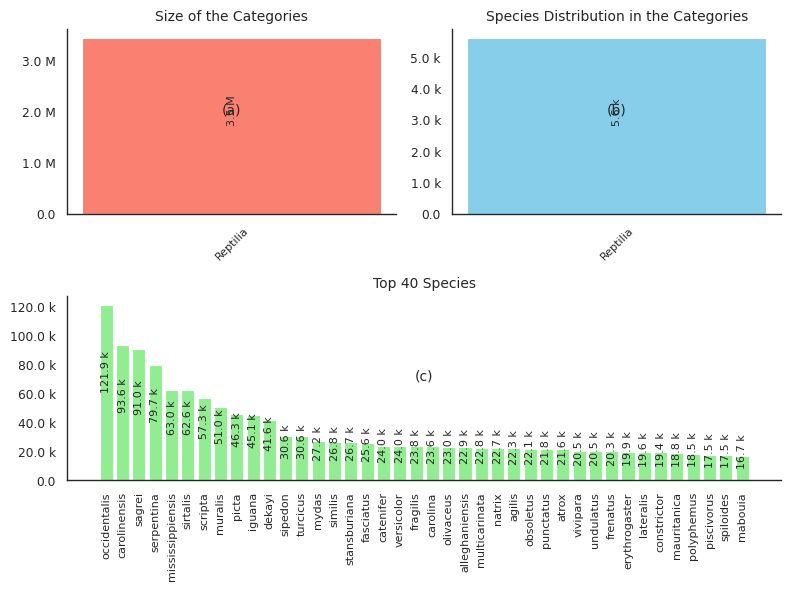

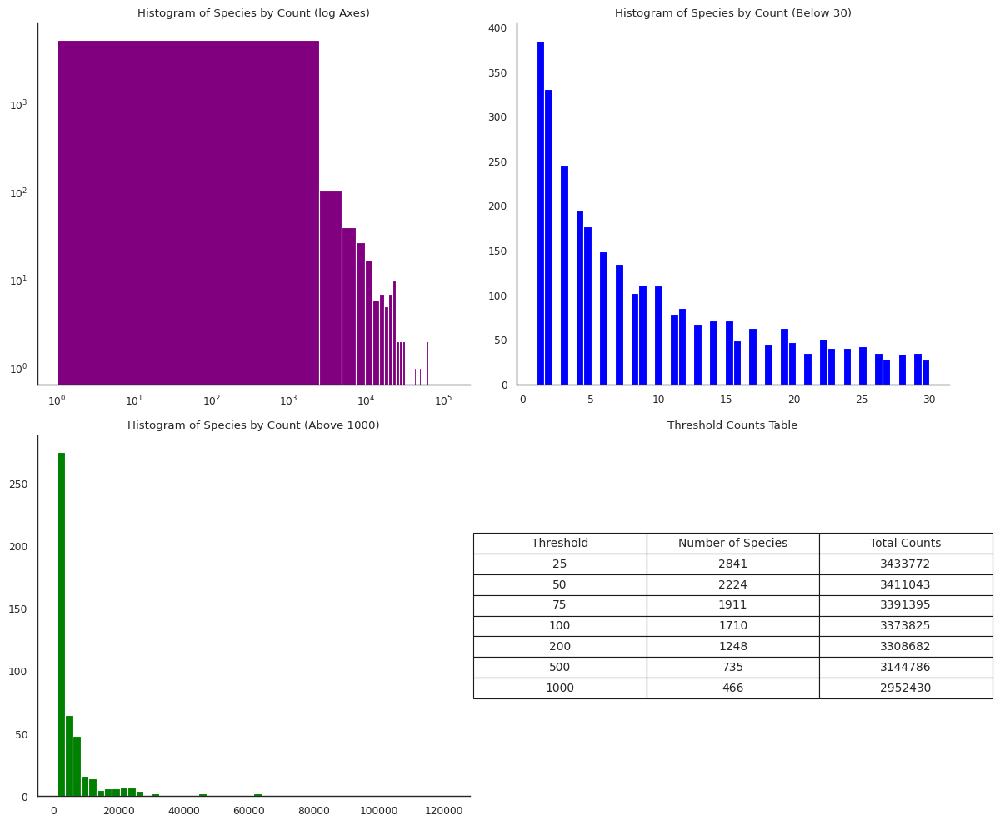

In [7]:
# Process the parquet files into csvs
print("Processing parquet files with MetadataProcessor")
print("=" * 60)

mp = MetadataProcessor(
    source_folder=str(PARAQUETS_PATH),
    destination_folder=str(OUT_DIR),
    categories=["Reptilia"],
)
mp.process_all_files()

print("\nMetadata processing complete")

# Step 7: GenShuffledChunks Override

In [8]:
# Generate shuffled chunks with filtering
# This filters the parquet read method to remove any non-reptilia data for efficient processing for our usage.

class GenShuffledChunksReptilia(GenShuffledChunks):
    def process_files(self):
        """
        Process files based on configuration parameters. Filters rare cases,
        caps frequent cases, and shuffles the data into specified parts.
        """
        start_time = time.time()

        final_counts = pd.read_csv(self.species_count_data)
        rare_case = set(final_counts[final_counts['count'] < self.rare_threshold]['species'])
        frequent_case = set(final_counts[final_counts['count'] > self.cap_threshold]['species'])

        for dir_path in [self.rare_dir, self.cap_filtered_dir_train, self.capped_dir, self.merged_dir]:
            if os.path.exists(dir_path):
                shutil.rmtree(dir_path)
            os.makedirs(dir_path, exist_ok=True)

        frequent_counts = {}
        capped_cases = []
        files = [f for f in os.listdir(self.directory) if f.endswith(".parquet")]

        for filename in tqdm(files, desc="Processing files"):
            filepath = os.path.join(self.directory, filename)
            # KEY FIX: Add filter to only read Reptilia class
            df = pd.read_parquet(filepath, filters=[("class", "==", "Reptilia")]).dropna()

            rare_df = df[df['species'].isin(rare_case)]
            capped_filtered_df = df[~df['species'].isin(rare_case)]

            rare_df.to_parquet(os.path.join(self.rare_dir, filename), index=False)

            frequent_df = capped_filtered_df[capped_filtered_df['species'].isin(frequent_case)]
            frequent_case_counts = frequent_df['species'].value_counts().to_dict()

            for case, count in frequent_case_counts.items():
                frequent_counts[case] = frequent_counts.get(case, 0) + count
                if frequent_counts[case] > self.cap_threshold and case not in capped_cases:
                    capped_cases.append(case)
                    cap_case_df = frequent_df[frequent_df['species'] == case]
                    cap_case_df.to_parquet(os.path.join(self.capped_dir, f'capped_{case}.parquet'), index=False)

            capped_df = capped_filtered_df[~capped_filtered_df['species'].isin(capped_cases)]
            df_shuffled = capped_df.sample(frac=1, random_state=self.random_seed).reset_index(drop=True)
            num_parts = max(1, round(len(df_shuffled) / self.part_size))
            rows_per_part = len(df_shuffled) // num_parts

            df_parts = [df_shuffled.iloc[i * rows_per_part: (i + 1) * rows_per_part] for i in range(num_parts)]

            if len(df_shuffled) % num_parts != 0:
                df_parts[-1] = pd.concat([df_parts[-1], df_shuffled.iloc[num_parts * rows_per_part:]], ignore_index=True)

            base_filename, _ = os.path.splitext(filename)
            for i, part in enumerate(df_parts):
                cap_filtered_filepath = os.path.join(self.cap_filtered_dir_train, f'{base_filename}_part{i+1}.parquet')
                part.to_parquet(cap_filtered_filepath, index=False)

        self.merge_shuffled_files()
        elapsed_time = time.time() - start_time
        print(f"Processing completed in {elapsed_time:.2f} seconds.")

print("GenShuffledChunksReptilia class defined")

GenShuffledChunksReptilia class defined


# Step 8: Generate Shuffled and Balanced Chunks

Process the data with filtering and balancing:
- Drop species with < 1000 samples (rare threshold)
- Cap species at 50 samples max (cap threshold)
- Shuffle and organize into chunks

In [9]:
# Generate shuffled chunks with filtering
print("Generating shuffled and balanced chunks")
print("=" * 60)
print("Configuration:")
print("  - Rare threshold: 1000 (drop species with <1000 samples)")
print("  - Cap threshold: 50 (cap species above this count)")
print("  - Part size: 500 rows per shuffled part")
print()

gen = GenShuffledChunksReptilia(
    species_count_data=COUNTS,
    directory=PARAQUETS_PATH,
    rare_threshold=1000,          # drop species with <1000 samples
    cap_threshold=50,             # cap species above this count
    part_size=500,                # rows per shuffled part
    rare_dir=str(FILTERED_OUT / "rare_cases"),
    cap_filtered_dir_train=str(FILTERED_OUT / "cap_filtered_train"),
    capped_dir=str(FILTERED_OUT / "capped_cases"),
    merged_dir=str(FILTERED_OUT / "merged_cases"),
    files_per_chunk=80,
    random_seed=521,
)
gen.process_files()

print("\nChunk generation complete.")

Generating shuffled and balanced chunks
Configuration:
  - Rare threshold: 1000 (drop species with <1000 samples)
  - Cap threshold: 50 (cap species above this count)
  - Part size: 500 rows per shuffled part



Merging files:   3%|▎         | 1/34 [00:42<23:33, 42.85s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0001.parquet


Merging files:   6%|▌         | 2/34 [00:44<09:47, 18.37s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0002.parquet


Merging files:   9%|▉         | 3/34 [00:45<05:26, 10.52s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0003.parquet


Merging files:  12%|█▏        | 4/34 [00:46<03:22,  6.74s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0004.parquet


Merging files:  15%|█▍        | 5/34 [00:47<02:14,  4.64s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0005.parquet


Merging files:  18%|█▊        | 6/34 [00:47<01:33,  3.34s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0006.parquet


Merging files:  21%|██        | 7/34 [00:48<01:08,  2.53s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0007.parquet


Merging files:  24%|██▎       | 8/34 [00:49<00:51,  2.00s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0008.parquet


Merging files:  26%|██▋       | 9/34 [00:50<00:39,  1.58s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0009.parquet


Merging files:  29%|██▉       | 10/34 [00:51<00:31,  1.31s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0010.parquet


Merging files:  32%|███▏      | 11/34 [00:51<00:26,  1.16s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0011.parquet


Merging files:  35%|███▌      | 12/34 [00:52<00:22,  1.03s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0012.parquet


Merging files:  38%|███▊      | 13/34 [00:53<00:19,  1.06it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0013.parquet


Merging files:  41%|████      | 14/34 [00:54<00:17,  1.14it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0014.parquet


Merging files:  44%|████▍     | 15/34 [00:54<00:15,  1.20it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0015.parquet


Merging files:  47%|████▋     | 16/34 [00:55<00:14,  1.22it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0016.parquet


Merging files:  50%|█████     | 17/34 [00:56<00:14,  1.17it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0017.parquet


Merging files:  53%|█████▎    | 18/34 [00:57<00:14,  1.13it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0018.parquet


Merging files:  56%|█████▌    | 19/34 [00:58<00:14,  1.03it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0019.parquet


Merging files:  59%|█████▉    | 20/34 [00:59<00:14,  1.03s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0020.parquet


Merging files:  62%|██████▏   | 21/34 [01:00<00:13,  1.04s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0021.parquet


Merging files:  65%|██████▍   | 22/34 [01:02<00:13,  1.09s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0022.parquet


Merging files:  68%|██████▊   | 23/34 [01:02<00:11,  1.02s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0023.parquet


Merging files:  71%|███████   | 24/34 [01:03<00:09,  1.04it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0024.parquet


Merging files:  74%|███████▎  | 25/34 [01:04<00:08,  1.10it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0025.parquet


Merging files:  76%|███████▋  | 26/34 [01:05<00:06,  1.19it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0026.parquet


Merging files:  79%|███████▉  | 27/34 [01:05<00:05,  1.22it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0027.parquet


Merging files:  82%|████████▏ | 28/34 [01:06<00:04,  1.28it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0028.parquet


Merging files:  85%|████████▌ | 29/34 [01:07<00:03,  1.25it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0029.parquet


Merging files:  88%|████████▊ | 30/34 [01:08<00:03,  1.27it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0030.parquet


Merging files:  91%|█████████ | 31/34 [01:09<00:02,  1.21it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0031.parquet


Merging files:  94%|█████████▍| 32/34 [01:09<00:01,  1.25it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0032.parquet


Merging files:  97%|█████████▋| 33/34 [01:10<00:00,  1.30it/s]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0033.parquet


Merging files: 100%|██████████| 34/34 [01:11<00:00,  2.10s/it]

Saved merged chunk: /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0034.parquet
Merging completed in 71.61 seconds.
Processing completed in 486.46 seconds.

Chunk generation complete.


# Step 9: Verify Filtered Dataset

In [10]:
# Verify the filtered parquet files
import pyarrow.parquet as pq

print("VERIFICATION: Filtered Dataset")
print("=" * 60)

parquet_dir = INPUT_PARQUETS
total_rows = 0
files = sorted(Path(parquet_dir).glob("*.parquet"))

for f in files:
    total_rows += pq.ParquetFile(f).metadata.num_rows

print(f"Parquet files: {len(files)}")
print(f"Total rows: {total_rows:,}")
print()

# Load a sample to check structure
if files:
    sample_df = pd.read_parquet(files[0])
    print(f"Columns: {list(sample_df.columns)}")
    print(f"\nFirst few rows:")
    print(sample_df.head(3))

print("\n" + "=" * 60)

VERIFICATION: Filtered Dataset
Parquet files: 34
Total rows: 13,368

Columns: ['photo_id', 'scientificName', 'kingdom', 'phylum', 'class', 'order', 'family', 'genus', 'species', 'common_name', 'taxonRank', 'photo_url']

First few rows:
   photo_id               scientificName   kingdom    phylum     class  \
0   2851670          Podarcis tiliguerta  Animalia  Chordata  Reptilia   
1   2548622            Mauremys reevesii  Animalia  Chordata  Reptilia   
2   1000103  Philothamnus semivariegatus  Animalia  Chordata  Reptilia   

        order       family         genus         species  \
0    Squamata   Lacertidae      Podarcis      tiliguerta   
1  Testudines  Geoemydidae      Mauremys        reevesii   
2    Squamata   Colubridae  Philothamnus  semivariegatus   

              common_name taxonRank  \
0  Tyrrhenian Wall Lizard   species   
1     Chinese Pond Turtle   species   
2      Spotted Bush Snake   species   

                                           photo_url  
0  http://inat

# Step 10: Download Images

In [11]:
# Download images with high concurrency using the GetImages class.
print("Downloading images")
print("=" * 60)
print(f"Output directory: {IMG_DIR}")
print(f"Concurrent downloads: 1000")
print()

gi = GetImages(
    INPUT_PARQUETS,
    output_folder=str(IMG_DIR),
    concurrent_downloads=1000,
)
await gi.download_images()

print("\nImage download complete.")

# Count downloaded images
image_files = list(IMG_DIR.rglob("*.jpg"))
print(f"Downloaded images: {len(image_files)}")

Output directory: /content/drive/MyDrive/herpeton/data/biotrove_train/images_reptilia
Concurrent downloads: 1000



  0%|          | 1/520 [00:00<04:58,  1.74it/s]

Error downloading image None: HTTP error: 404


 78%|███████▊  | 407/520 [00:08<00:01, 71.50it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 520/520 [00:09<00:00, 55.08it/s] 


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0001.parquet with 2 errors.


 15%|█▍        | 105/719 [00:01<00:08, 75.96it/s]

Error downloading image None: HTTP error: 404
Error downloading image None: HTTP error: 404
Error downloading image None: HTTP error: 404
Error downloading image None: HTTP error: 404


 37%|███▋      | 269/719 [00:04<00:06, 69.91it/s]

Error downloading image None: HTTP error: 404


 51%|█████▏    | 369/719 [00:05<00:03, 92.16it/s]

Error downloading image None: HTTP error: 404


 71%|███████▏  | 513/719 [00:08<00:02, 69.60it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 719/719 [00:11<00:00, 64.35it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0002.parquet with 7 errors.


 75%|███████▌  | 631/836 [00:10<00:02, 78.32it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 836/836 [00:12<00:00, 69.50it/s] 


Error downloading image None: HTTP error: 404
Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0003.parquet with 2 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0004.parquet with 0 errors.


100%|██████████| 29/29 [00:00<00:00, 82.53it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0005.parquet with 0 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0006.parquet with 0 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0007.parquet with 0 errors.


100%|██████████| 18/18 [00:00<00:00, 63.18it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0008.parquet with 0 errors.


100%|██████████| 530/530 [00:09<00:00, 55.37it/s]

Error downloading image None: HTTP error: 404
Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0009.parquet with 1 errors.



 22%|██▏       | 211/962 [00:04<00:15, 49.67it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 962/962 [00:15<00:00, 62.14it/s] 


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0010.parquet with 1 errors.


 19%|█▉        | 308/1612 [00:06<00:23, 56.28it/s]

Error downloading image None: HTTP error: 404
Error downloading image None: HTTP error: 404


 51%|█████▏    | 830/1612 [00:15<00:10, 76.71it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 1612/1612 [00:26<00:00, 61.54it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0011.parquet with 3 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0012.parquet with 0 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0013.parquet with 0 errors.


 64%|██████▎   | 329/518 [00:07<00:02, 67.26it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 518/518 [00:08<00:00, 59.30it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0014.parquet with 1 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0015.parquet with 0 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0016.parquet with 0 errors.


100%|██████████| 523/523 [00:07<00:00, 69.59it/s]


Error downloading image None: HTTP error: 404
Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0017.parquet with 1 errors.


  0%|          | 1/522 [00:02<24:49,  2.86s/it]

Error downloading image None: HTTP error: 404


100%|██████████| 522/522 [00:09<00:00, 55.70it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0018.parquet with 1 errors.


100%|██████████| 588/588 [00:07<00:00, 74.61it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0019.parquet with 0 errors.


  9%|▉         | 95/1041 [00:01<00:14, 67.26it/s]

Error downloading image None: HTTP error: 404


 34%|███▍      | 359/1041 [00:05<00:07, 91.38it/s]

Error downloading image None: HTTP error: 404


 86%|████████▌ | 895/1041 [00:12<00:01, 75.51it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 1041/1041 [00:14<00:00, 71.02it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0020.parquet with 3 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0021.parquet with 0 errors.


 25%|██▌       | 143/566 [00:02<00:06, 61.87it/s]

Error downloading image None: HTTP error: 404


 36%|███▌      | 203/566 [00:03<00:06, 55.23it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 566/566 [00:07<00:00, 78.56it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0022.parquet with 2 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0023.parquet with 0 errors.


100%|██████████| 518/518 [00:07<00:00, 73.57it/s] 


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0024.parquet with 0 errors.


100%|██████████| 462/462 [00:06<00:00, 73.49it/s] 


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0025.parquet with 0 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0026.parquet with 0 errors.


100%|██████████| 518/518 [00:07<00:00, 73.70it/s] 


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0027.parquet with 0 errors.


  0%|          | 1/523 [00:01<15:03,  1.73s/it]

Error downloading image None: HTTP error: 404


100%|██████████| 523/523 [00:07<00:00, 73.57it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0028.parquet with 1 errors.


  0%|          | 1/518 [00:01<12:56,  1.50s/it]

Error downloading image None: HTTP error: 404


100%|██████████| 518/518 [00:06<00:00, 78.72it/s] 


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0029.parquet with 1 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0030.parquet with 0 errors.


 31%|███       | 243/791 [00:04<00:08, 68.41it/s]

Error downloading image None: HTTP error: 404


 63%|██████▎   | 497/791 [00:07<00:02, 98.15it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 791/791 [00:10<00:00, 75.89it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0031.parquet with 2 errors.


 56%|█████▌    | 291/523 [00:04<00:02, 90.98it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 523/523 [00:06<00:00, 79.66it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0032.parquet with 1 errors.


 19%|█▉        | 101/531 [00:02<00:06, 63.44it/s]

Error downloading image None: HTTP error: 404


100%|██████████| 531/531 [00:07<00:00, 73.83it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0033.parquet with 1 errors.


0it [00:00, ?it/s]


Completed /content/drive/MyDrive/herpeton/data/biotrove_train/filtered_reptilia/merged_cases/processed_chunks_0034.parquet with 0 errors.

Image download complete.
Downloaded images: 13338


# Step 11: Generate Image-Text Pairs

In [ ]:
# Generate image-text pairs for ML training
print("Generating image-text pairs")
print("=" * 60)

textgen = GenImgTxtPair(
    INPUT_PARQUETS,
    img_folder=IMG_DIR,
    generate_tar=True,
)

textgen.create_image_text_pairs()

print("\nImage-text pairs generated.")

Generating image-text pairs
Text files for processed_chunks_0001 created in 135.57 seconds.
Tar file for processed_chunks_0001 created: /content/drive/MyDrive/herpeton/data/biotrove_train/images_reptilia_tar/processed_chunks_0001.tar in 112.43 seconds.


# Step 12: Create Train/Val/Test Splits

In [ ]:
# Create balanced train/val/test splits of 80/10/10 with a minimum image count per class of 20.
print("Creating dataset splits")
print("=" * 60)

min_images_per_class = 20
split_ratios = {"train": 0.8, "val": 0.1, "test": 0.1}

print(f"Configuration:")
print(f"  - Minimum images per class: {min_images_per_class}")
print(f"  - Train: {split_ratios['train']*100:.0f}%")
print(f"  - Val: {split_ratios['val']*100:.0f}%")
print(f"  - Test: {split_ratios['test']*100:.0f}%")
print()

# Check available images before splitting to ensure the data stays balanced
available_ids = {int(p.stem) for p in IMG_DIR.rglob("*.jpg")}
print(f"Images found: {len(available_ids)}")

dfs = []
for p in Path(INPUT_PARQUETS).glob("*.parquet"):
    df = pd.read_parquet(p, columns=["photo_id", "scientificName", "photo_url"])
    dfs.append(df)

meta = pd.concat(dfs, ignore_index=True).dropna(subset=["photo_id", "scientificName", "photo_url"])

meta["photo_id"] = meta["photo_id"].astype(int)
meta = meta[meta["photo_id"].isin(available_ids)].drop_duplicates(subset=["photo_id"], keep=False)

print(f"Rows with images: {len(meta['photo_id'].unique())}")

class_counts = meta["scientificName"].value_counts()
keep_classes = set(class_counts[class_counts >= min_images_per_class].index)
print(f"Classes kept (>= {min_images_per_class} images): {len(keep_classes)}")
print(f"Classes dropped: {len(class_counts) - len(keep_classes)}")

meta = meta[meta["scientificName"].isin(keep_classes)].copy()
print(f"Rows after class filter: {len(meta)}")
print()

# Create splits
rng = random.Random(521)
rows = []
for label, g in meta.groupby("scientificName"):
    ids = g["photo_id"].tolist()
    rng.shuffle(ids)
    n = len(ids)
    train_n = int(n * split_ratios["train"])
    val_n = int((n - train_n) // 2)

    for pid in ids[:train_n]:
        rows.append((pid, "train"))
    for pid in ids[train_n:train_n + val_n]:
        rows.append((pid, "test"))
    for pid in ids[train_n + val_n:]:
        rows.append((pid, "val"))

split_df = pd.DataFrame(rows, columns=["photo_id", "split"])
split_lookup = dict(zip(split_df.photo_id, split_df.split))

meta["split"] = meta["photo_id"].map(split_lookup)

print("=" * 60)
print("SPLIT DISTRIBUTION:")
print(split_df["split"].value_counts())
print()

print("Rows per split:")
print(meta["split"].value_counts())
print()

# Per-class distribution
per_class = meta.groupby(["scientificName", "split"]).size().unstack(fill_value=0)
print("Per-class counts (train/val/test) - first 10:")
print(per_class.head(10))
print()

# Simple imbalance stats
train_counts = per_class["train"]
val_counts = per_class["val"]
test_counts = per_class["test"]
print("BALANCE STATISTICS:")
print(f"Train min/median/max: {train_counts.min()} / {train_counts.median():.0f} / {train_counts.max()}")
print(f"Val   min/median/max: {val_counts.min()} / {val_counts.median():.0f} / {val_counts.max()}")
print(f"Test  min/median/max: {test_counts.min()} / {test_counts.median():.0f} / {test_counts.max()}")

print("\nDataset splits created.")

# Step 13: Final Dataset Statistics and Exploration

In [ ]:
# Final dataset statistics
print("FINAL DATASET STATISTICS")
print("=" * 60)

print(f"\nTOTAL DATASET:")
print(f"  Total samples: {len(meta):,}")
print(f"  Unique species: {meta['scientificName'].nunique()}")
print(f"  Images available: {len(available_ids):,}")

print(f"\nSPLIT BREAKDOWN:")
for split in ["train", "val", "test"]:
    split_data = meta[meta["split"] == split]
    print(f"  {split.capitalize():5s}: {len(split_data):,} samples ({len(split_data)/len(meta)*100:.1f}%)")

print(f"\nTOP 15 SPECIES BY SAMPLE COUNT:")
species_counts = meta["scientificName"].value_counts().head(15)
for idx, (species, count) in enumerate(species_counts.items(), 1):
    print(f"  {idx:2d}. {species:<40s}: {count:3d} samples")

print("\n" + "=" * 60)
print("Dataset processing complete.")
print(f"Ready for computer vision model training.")

# Step 14: Visualize Dataset Distribution

In [ ]:
# Visualize dataset statistics
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style("whitegrid")
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# 1. Split distribution
ax1 = axes[0, 0]
split_counts = meta["split"].value_counts()
split_counts.plot(kind='bar', ax=ax1, color=['#2ecc71', '#3498db', '#e74c3c'])
ax1.set_title('Dataset Split Distribution', fontsize=14, fontweight='bold')
ax1.set_xlabel('Split', fontsize=12)
ax1.set_ylabel('Number of Samples', fontsize=12)
ax1.tick_params(axis='x', rotation=0)
for i, v in enumerate(split_counts.values):
    ax1.text(i, v + 50, str(v), ha='center', va='bottom', fontweight='bold')

# 2. Top 15 species distribution
ax2 = axes[0, 1]
top_species = meta["scientificName"].value_counts().head(15)
top_species.plot(kind='barh', ax=ax2, color='#9b59b6')
ax2.set_title('Top 15 Species by Sample Count', fontsize=14, fontweight='bold')
ax2.set_xlabel('Number of Samples', fontsize=12)
ax2.set_ylabel('Species', fontsize=12)
ax2.invert_yaxis()

# 3. Samples per class distribution
ax3 = axes[1, 0]
samples_per_class = meta["scientificName"].value_counts()
ax3.hist(samples_per_class, bins=20, color='#e67e22', edgecolor='black')
ax3.set_title('Distribution of Samples per Class', fontsize=14, fontweight='bold')
ax3.set_xlabel('Number of Samples per Species', fontsize=12)
ax3.set_ylabel('Number of Species', fontsize=12)
ax3.axvline(samples_per_class.median(), color='red', linestyle='--', linewidth=2, label=f'Median: {samples_per_class.median():.0f}')
ax3.legend()

# 4. Split balance per class (showing mean, min, max)
ax4 = axes[1, 1]
split_stats = per_class.agg(['mean', 'min', 'max'])
split_stats.T.plot(kind='bar', ax=ax4, color=['#16a085', '#c0392b', '#f39c12'])
ax4.set_title('Train/Val/Test Balance Statistics', fontsize=14, fontweight='bold')
ax4.set_xlabel('Split', fontsize=12)
ax4.set_ylabel('Samples per Class', fontsize=12)
ax4.tick_params(axis='x', rotation=0)
ax4.legend(['Mean', 'Min', 'Max'])

plt.tight_layout()
plt.savefig(DATA_ROOT / 'dataset_statistics.png', dpi=300, bbox_inches='tight')
print(f"Visualization saved to: {DATA_ROOT / 'dataset_statistics.png'}")
plt.show()

# Step 15: Save Final Dataset Metadata

In [ ]:
# Save final metadata
output_metadata_path = DATA_ROOT / "reptilia_dataset_final.csv"
meta.to_csv(output_metadata_path, index=False)
print(f"Final dataset metadata saved to: {output_metadata_path}")
print(f"  Total records: {len(meta):,}")
print(f"  Columns: {', '.join(meta.columns)}")

# Create a summary file
summary = {
    "total_samples": len(meta),
    "unique_species": meta["scientificName"].nunique(),
    "train_samples": len(meta[meta["split"] == "train"]),
    "val_samples": len(meta[meta["split"] == "val"]),
    "test_samples": len(meta[meta["split"] == "test"]),
    "min_images_per_class": min_images_per_class,
    "split_ratios": split_ratios,
    "rare_threshold": 1000,
    "cap_threshold": 50,
    "processing_date": time.strftime("%Y-%m-%d %H:%M:%S")
}

summary_path = DATA_ROOT / "dataset_summary.json"
with open(summary_path, 'w') as f:
    json.dump(summary, f, indent=2)

print(f"Dataset summary saved to: {summary_path}")
print("\n" + "=" * 60)
print("ALL PROCESSING COMPLETE!")
print("=" * 60)
print("\nDataset is ready for training. Key files:")
print(f"  1. Metadata: {output_metadata_path}")
print(f"  2. Images: {IMG_DIR}")
print(f"  3. Summary: {summary_path}")
print(f"  4. Visualization: {DATA_ROOT / 'dataset_statistics.png'}")